In [1]:
import gdown  # libreria para descargar archivos grandes desde Google Drive
import pandas as pd
import plotly.express as px
import seaborn as sns

In [2]:
pd.set_option('display.max_columns', 500)  # Mostrar mas columnas de un DataFrame
sns.set(style="darkgrid")

In [3]:
file_id = '1D31Z6sUCVUynRyimxs2n8rrULnlwhP9l'
url = f'https://drive.google.com/uc?id={file_id}'
output = 'data/jigsaw_data.zip'
# gdown.download(url, output)

In [4]:
comments = pd.read_csv(output, dtype=str)
print(f"El dataset tiene {comments.shape[0]} filas y {comments.shape[1]} columnas.")
comments.head()

El dataset tiene 1999516 filas y 46 columnas.


,id,comment_text,split,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,toxicity,severe_toxicity,obscene,sexual_explicit,identity_attack,insult,threat,male,female,transgender,other_gender,heterosexual,homosexual_gay_or_lesbian,bisexual,other_sexual_orientation,christian,jewish,muslim,hindu,buddhist,atheist,other_religion,black,white,asian,latino,other_race_or_ethnicity,physical_disability,intellectual_or_learning_disability,psychiatric_or_mental_illness,other_disability,identity_annotator_count,toxicity_annotator_count
0,1083994,He got his money... now he lies in wait till a...,train,2017-03-06 15:21:53.675241+00,21,NaN,317120,approved,0,0,0,2,0,0.373134328358209,0.04477611940298507,0.08955223880597014,0.01492537313432836,0.0,0.34328358208955223,0.01492537313432836,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,67
1,650904,Mad dog will surely put the liberals in mental...,train,2016-12-02 16:44:21.329535+00,21,NaN,154086,approved,0,0,1,2,0,0.6052631578947368,0.013157894736842105,0.06578947368421052,0.013157894736842105,0.09210526315789473,0.5657894736842105,0.06578947368421052,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,76
2,5902188,And Trump continues his lifelong cowardice by ...,train,2017-09-05 19:05:32.341360+00,55,NaN,374342,approved,1,0,2,3,7,0.6666666666666666,0.015873015873015872,0.031746031746031744,0.0,0.047619047619047616,0.6666666666666666,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,63
3,7084460,"""while arresting a man for resisting arrest"".\...",test,2016-11-01 16:53:33.561631+00,13,NaN,149218,approved,0,0,0,0,0,0.8157894736842106,0.06578947368421052,0.5526315789473685,0.5921052631578946,0.0,0.6842105263157895,0.10526315789473684,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,76
4,5410943,Tucker and Paul are both total bad ass mofo's.,train,2017-06-14 05:08:21.997315+00,21,NaN,344096,approved,0,0,0,1,0,0.55,0.0375,0.3375,0.275,0.0375,0.4875,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,80


In [5]:
comments["split"].value_counts()

split
train    1804875
test      194641
Name: count, dtype: int64

<Axes: title={'center': 'Toxicity distribution'}, ylabel='Frequency'>

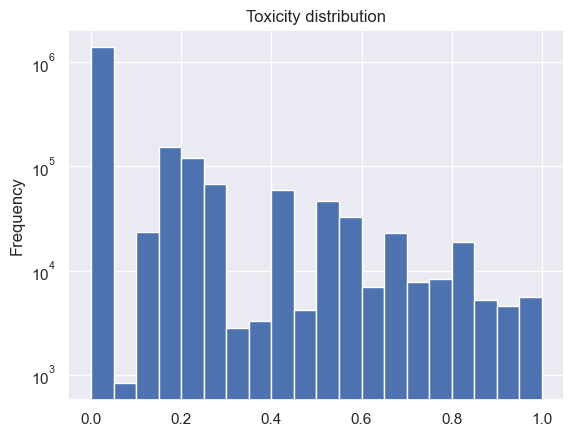

In [6]:
comments["toxicity"] = pd.to_numeric(comments["toxicity"])
comments["toxicity"].plot( kind='hist', bins=20, title='Toxicity distribution' , logy=True)

In [10]:
comments["rating"].value_counts()
# plot with plotly
fig = px.histogram(comments, x="rating", title='Rating distribution')
fig.show()

In [ ]:
comments[comments["comment_text"].isna()]

In [ ]:
comments["len_text"] = comments["comment_text"].str.len()
comments["len_text"].plot( kind='hist', bins=20, title='Comment length distribution' )
comments["len_text"].describe()

In [ ]:
comments.query("len_text < 3")["comment_text"].value_counts().head(20)

In [18]:
import spacy
from unidecode import unidecode
from sklearn.feature_extraction.text import CountVectorizer


def preprocess(text):
    text = unidecode(text).lower()
    # doc = nlp(text)
    # tokens = [token.text for token in doc if not token.is_punct and not token.is_stop]
    return text


def get_bow(preprocess_corpus) -> tuple:
    vect = CountVectorizer(max_features=1000).fit(preprocess_corpus)
    X = vect.transform(preprocess_corpus).toarray()
    return X, vect


nlp = spacy.load("en_core_web_sm")
test_df = comments.sample(1000)

In [19]:
preprocess_text = test_df["comment_text"].apply(preprocess)
X, vect = get_bow(preprocess_text)

In [28]:
wourd_counts: dict[str, int] = (
    pd.DataFrame(X, columns=vect.get_feature_names_out()).sum().sort_values().to_dict()
)

(-0.5, 799.5, 399.5, -0.5)

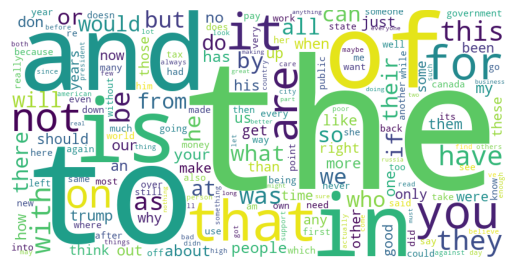

In [30]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def get_wordcloud(X, vect):
    ### ESCRIBA SU CÓDIGO AQUÍ ###
    vocab = vect.get_feature_names_out()
    count_dict = dict(zip(vocab, X.sum(axis=0)))
    wc = WordCloud(
        width=800, height=400, background_color="#FFFFFF"
    ).generate_from_frequencies(count_dict)
    return wc


wc = get_wordcloud(X, vect)
fig, ax = plt.subplots()
ax.imshow(wc)
ax.axis("off")